<a href="https://colab.research.google.com/github/SD325/introtodeeplearning/blob/master/lab1/lab1_MIT6S191.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

In [1]:
%tensorflow_version 2.x
import tensorflow as tf 

!pip install mitdeeplearning
import mitdeeplearning as mdl

import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

# Check that we are using a GPU, if not switch runtimes
#   using Runtime > Change Runtime Type > GPU
assert len(tf.config.list_physical_devices('GPU')) > 0

# Get Data

In [2]:
songs = mdl.lab1.load_training_data()
print(f"type(songs): {type(songs)}\n")
print(f"songs[0]: \n{songs[0]}")
# play songs[0]
mdl.lab1.play_song(songs[0])

Found 816 songs in text
type(songs): <class 'list'>

songs[0]: 
X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!


In [3]:
# get unique characters from songs
all_songs_str = "\n\n".join(songs)
vocab = sorted(set(all_songs_str))
print(len(vocab))

83


In [4]:
# lookup tables
char_ind = {u:i for i, u in enumerate(vocab)}
ind_char = np.array(vocab)

print(f"char_ind: \n{char_ind}\n")
print(f"ind_char: \n{ind_char}\n")

char_ind: 
{'\n': 0, ' ': 1, '!': 2, '"': 3, '#': 4, "'": 5, '(': 6, ')': 7, ',': 8, '-': 9, '.': 10, '/': 11, '0': 12, '1': 13, '2': 14, '3': 15, '4': 16, '5': 17, '6': 18, '7': 19, '8': 20, '9': 21, ':': 22, '<': 23, '=': 24, '>': 25, 'A': 26, 'B': 27, 'C': 28, 'D': 29, 'E': 30, 'F': 31, 'G': 32, 'H': 33, 'I': 34, 'J': 35, 'K': 36, 'L': 37, 'M': 38, 'N': 39, 'O': 40, 'P': 41, 'Q': 42, 'R': 43, 'S': 44, 'T': 45, 'U': 46, 'V': 47, 'W': 48, 'X': 49, 'Y': 50, 'Z': 51, '[': 52, ']': 53, '^': 54, '_': 55, 'a': 56, 'b': 57, 'c': 58, 'd': 59, 'e': 60, 'f': 61, 'g': 62, 'h': 63, 'i': 64, 'j': 65, 'k': 66, 'l': 67, 'm': 68, 'n': 69, 'o': 70, 'p': 71, 'q': 72, 'r': 73, 's': 74, 't': 75, 'u': 76, 'v': 77, 'w': 78, 'x': 79, 'y': 80, 'z': 81, '|': 82}

ind_char: 
['\n' ' ' '!' '"' '#' "'" '(' ')' ',' '-' '.' '/' '0' '1' '2' '3' '4' '5'
 '6' '7' '8' '9' ':' '<' '=' '>' 'A' 'B' 'C' 'D' 'E' 'F' 'G' 'H' 'I' 'J'
 'K' 'L' 'M' 'N' 'O' 'P' 'Q' 'R' 'S' 'T' 'U' 'V' 'W' 'X' 'Y' 'Z' '[' ']'
 '^' '_' 'a' 'b' '

In [5]:
def vectorize_string(string):
  return np.array([char_ind[char] for char in string])

vectorized_songs = vectorize_string(all_songs_str)
print(vectorized_songs)

[49 22 14 ... 22 82  2]


In [0]:
def get_batch(vectorized_songs, seq_length, batch_size):
  """
    Get batches for training
    
    Args:
        vectorized_songs (np.ndarray): numeric representation of all songs
        seq_length (int): length of input sequence to feed into RNN
        batch_size (int): 
    Returns:
        x_batch (np.ndarray): input for training
        y_batch (np.ndarray): targets for training
    """
  n = vectorized_songs.shape[0] - 1  # length of the vectorized songs string
  idx = np.random.choice(n-seq_length, batch_size)  # random start inds

  input_batch = [vectorized_songs[ix : ix + seq_length] for ix in idx]
  output_batch = [vectorized_songs[ix + 1 : ix + seq_length + 1] for ix in idx]

  # x_batch, y_batch provide the true inputs and targets for network training
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch

# The RNN Model

In [0]:
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Embedding, LSTM, Dense
from tensorflow.keras.losses import sparse_categorical_crossentropy

In [0]:
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    # Layer 1: Embedding layer to transform indices into dense vectors 
    # of a fixed embedding size
    Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

    # Layer 2: LSTM with `rnn_units` number of units. 
    LSTM(rnn_units, return_sequences=True, 
         recurrent_initializer='glorot_uniform', recurrent_activation='sigmoid',
         stateful=True,
         ),

    # Layer 3: Dense (fully-connected) layer that transforms the LSTM output
    # into the vocabulary size. 
    Dense(vocab_size)
  ])

  return model

In [0]:
def compute_loss(labels, logits):
  return sparse_categorical_crossentropy(labels, logits, from_logits=True)

# Hyperparameters

In [0]:
# Optimization parameters:
num_training_iterations = 2000  # Increase this to train longer
batch_size = 4  # Experiment between 1 and 64
seq_length = 100  # Experiment between 50 and 500
learning_rate = 5e-3  # Experiment between 1e-5 and 1e-1

# Model parameters: 
vocab_size = len(vocab)
embedding_dim = 256 
rnn_units = 1024  # Experiment between 1 and 2048

# Checkpoint location: 
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

# Train Model

## Back Propagation

In [0]:
@tf.function
def train_step(x, y): 
  with tf.GradientTape() as tape:
    # feed the current input into the model and generate predictions
    y_hat = model(x)
    # compute the loss
    loss = compute_loss(y, y_hat)

  # compute the gradients 
  grads = tape.gradient(loss, model.trainable_variables)
  
  # Apply the gradients to the optimizer so it can update the model accordingly
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss

## Model

In [0]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)

## Optimizer

In [0]:
optimizer = tf.keras.optimizers.Adam()

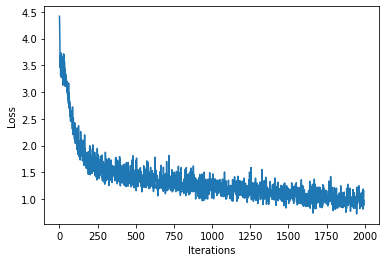

100%|██████████| 2000/2000 [03:23<00:00,  9.83it/s]


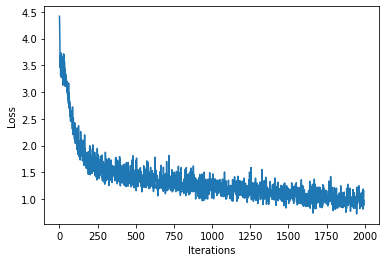

In [14]:
###################
# Begin training! #
###################

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):

  # Grab a batch and propagate it through the network
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  # Update the progress bar
  history.append(loss.numpy().mean())
  plotter.plot(history)

  # Update the model with the changed weights!
  if iter % 100 == 0:     
    model.save_weights(checkpoint_prefix)
    
# Save the trained model and the weights
model.save_weights(checkpoint_prefix)

# Generate Music using the RNN

In [15]:
# Rebuild the model (with batch_size=1 --> one song generated at a time)
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

# Restore the model weights for the last checkpoint after training
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (1, None, 256)            21248     
_________________________________________________________________
lstm_1 (LSTM)                (1, None, 1024)           5246976   
_________________________________________________________________
dense_1 (Dense)              (1, None, 83)             85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [0]:
# Generate song using RNN

def generate_text(model, start_string, generation_length=1000):
  # Evaluation step (generating ABC text using the learned RNN model)
  input_eval = vectorize_string(start_string)
  input_eval = tf.expand_dims(input_eval, 0)

  # Empty string to store our results
  text_generated = []

  # Here batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      # evaluate the inputs and generate the next character predictions
      predictions = model(input_eval)
      
      # Remove the batch dimension
      predictions = tf.squeeze(predictions, 0)
      
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
      
      # Pass the prediction along with the previous hidden state
      # as the next inputs to the model
      input_eval = tf.expand_dims([predicted_id], 0)
      
      # add the predicted character to the generated text!
      text_generated.append(ind_char[predicted_id])
    
  return (start_string + ''.join(text_generated))

In [17]:
generated_text = generate_text(model, start_string="X", generation_length=1000)

100%|██████████| 1000/1000 [00:08<00:00, 120.49it/s]


# Play Song

In [18]:
# Play back generated songs

generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs): 
  # Synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  # If its a valid song (correct syntax), lets play it! 
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 1 songs in text
Generated song 0
